# Setup the Detectron2

## Required Library Installation and Detectron Setup

In [ ]:
!python -m pip install pyyaml==5.1
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 4.8 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=efca05cc77d3779b69b96c4f8ab1d03c913671332dc38546a52477d1bd718d69
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.0 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/d

## Dataset Cloning from Github

In [ ]:
!git clone https://github.com/rootsid/csgodataset.git

Cloning into 'csgodataset'...
remote: Enumerating objects: 1636, done.
remote: Counting objects: 100% (246/246), done.
remote: Compressing objects: 100% (240/240), done.
remote: Total 1636 (delta 7), reused 245 (delta 6), pack-reused 1390
Receiving objects: 100% (1636/1636), 426.45 MiB | 43.38 MiB/s, done.
Resolving deltas: 100% (9/9), done.
Checking out files: 100% (1581/1581), done.


Verify the version of torch and detectron2 installation

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
torch:  1.12 ; cuda:  cu113
detectron2: 0.6


## Import Required Libraries

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Replication

Predicting from the base model on new dataset to demonstrate the issues with current model and requirement for new model training.

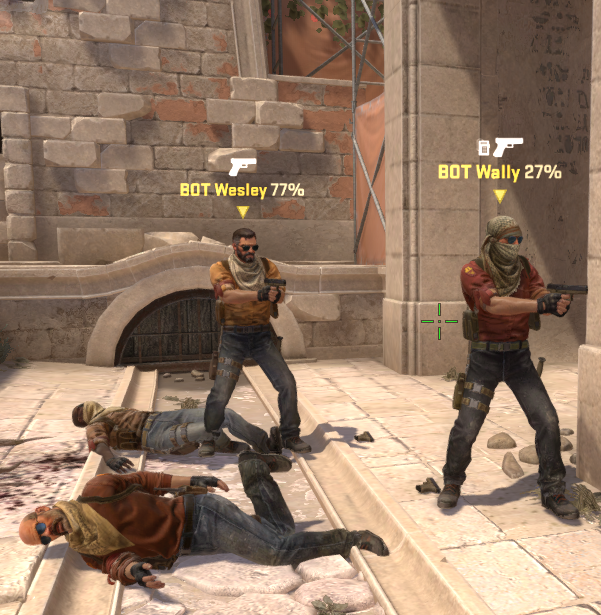

In [ ]:
im = cv2.imread("/content/csgodataset/Dataset/21.png")
cv2_imshow(im)

In [ ]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

model_final_280758.pkl: 167MB [00:03, 44.6MB/s]                           
/usr/local/lib/python3.7/dist-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2894.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


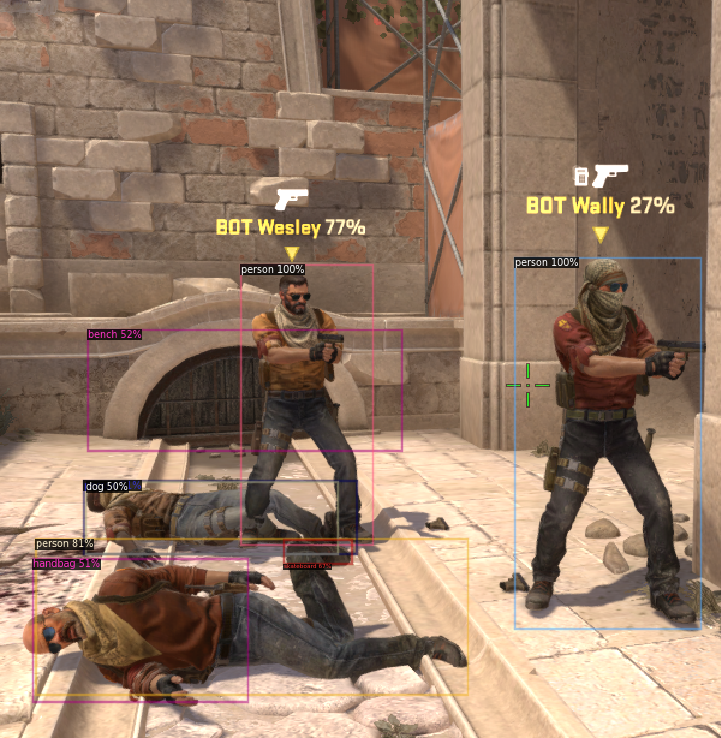

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

RetinaNet models detect the categories as "person". It would have been fine during the gameplay however, it detects the dead player as "person" category as well. This creates noice in aim snapping and automated bots to play games can not be created. Also, during the automated bot gameplay, charachter is not supposed to fire or team mates which will be detected as "person" category as well. To fix the above issues we need train again with different categories "CT" and "Ter".

# New Model Training

## Register the COCO format dataset in a experiment

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("experiment", {}, "/content/csgodataset/annotations.json", "/content/csgodataset/Dataset/")

In [ ]:
sample_metadata = MetadataCatalog.get("experiment")
dataset_dicts = DatasetCatalog.get("experiment")

WARNING [10/28 04:01:42 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/28 04:01:42 d2.data.datasets.coco]: Loaded 196 images in COCO format from /content/csgodataset/annotations.json


To verify the dataset is in correct format, let's visualize the annotations of randomly selected samples in the training set:



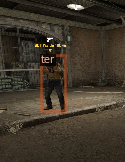

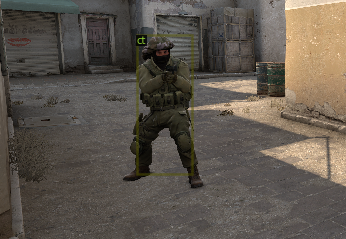

In [ ]:
import random

for d in random.sample(dataset_dicts, 2):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=sample_metadata, scale=0.25)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

Dataset is loaded correctly as it shows the correct labels with respective image instances.

## Training

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("experiment",)
cfg.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2 # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.02 # Best tested LR
cfg.SOLVER.MAX_ITER = 300 # Number of epochs
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 # Contain two classes, ter and ct

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[10/26 13:59:54 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:34, 4.91MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[10/26 14:00:32 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2894.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[10/26 14:00:48 d2.utils.events]:  eta: 0:01:52  iter: 19  total_loss: 1.017  loss_cls: 0.4114  loss_box_reg: 0.4638  loss_rpn_cls: 0.003253  loss_rpn_loc: 0.004849  time: 0.4111  data_time: 0.0310  lr: 0.0012854  max_mem: 2727M
[10/26 14:00:57 d2.utils.events]:  eta: 0:01:48  iter: 39  total_loss: 0.7135  loss_cls: 0.2018  loss_box_reg: 0.5127  loss_rpn_cls: 0.00096  loss_rpn_loc: 0.002777  time: 0.4196  data_time: 0.0119  lr: 0.0026174  max_mem: 2727M
[10/26 14:01:05 d2.utils.events]:  eta: 0:01:40  iter: 59  total_loss: 0.5629  loss_cls: 0.1572  loss_box_reg: 0.3629  loss_rpn_cls: 5.303e-05  loss_rpn_loc: 0.003785  time: 0.4228  data_time: 0.0111  lr: 0.0039494  max_mem: 2727M
[10/26 14:01:14 d2.utils.events]:  eta: 0:01:35  iter: 79  total_loss: 0.4569  loss_cls: 0.1601  loss_box_reg: 0.2771  loss_rpn_cls: 0.002871  loss_rpn_loc: 0.00482  time: 0.4269  data_time: 0.0096  lr: 0.0052814  max_mem: 2727M
[10/26 14:01:23 d2.utils.events]:  eta: 0:01:27  iter: 99  total_loss: 0.4202  los

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Evaluation of Trained  Model

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth") # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6   # set the testing threshold for this model
cfg.DATASETS.TEST = ("experiment",)
predictor = DefaultPredictor(cfg)

[10/26 14:03:06 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

### Human Evaluation

 We can pick one image which is difficult and got multiple characters in one image intance to see the accuracy in real-time scenario.Then, we randomly select several samples to visualize the prediction results.

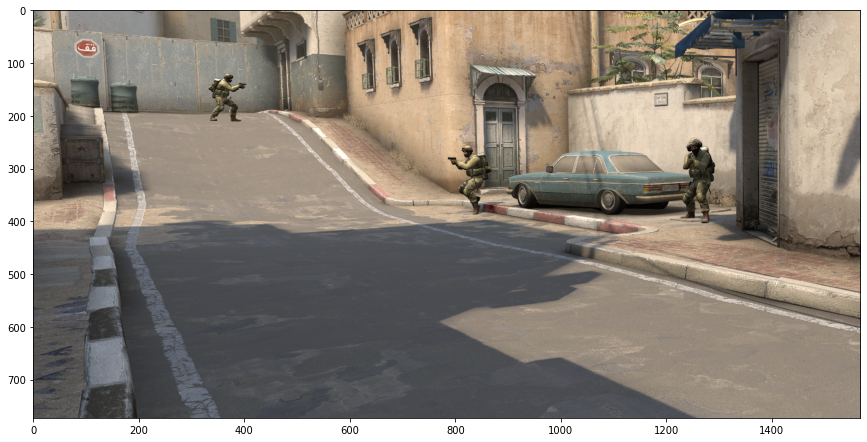

In [ ]:
from detectron2.utils.visualizer import ColorMode
import matplotlib.pyplot as plt
im = cv2.imread("/content/csgodataset/Dataset/163.png")
plt.figure(figsize=(15,7.5))
plt.imshow(im[..., ::-1])

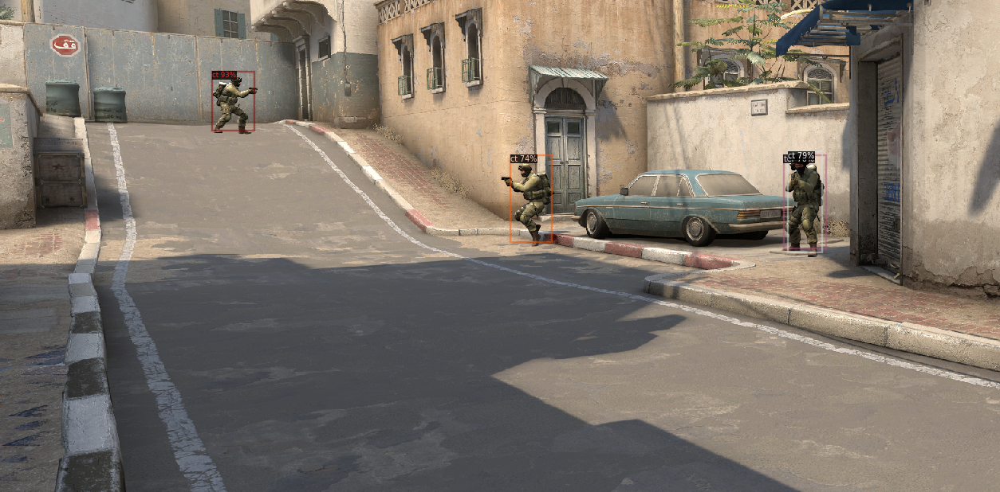

In [ ]:
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                   metadata=sample_metadata, 
                   scale=0.8 
    )

v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

/content/csgodataset/167.png


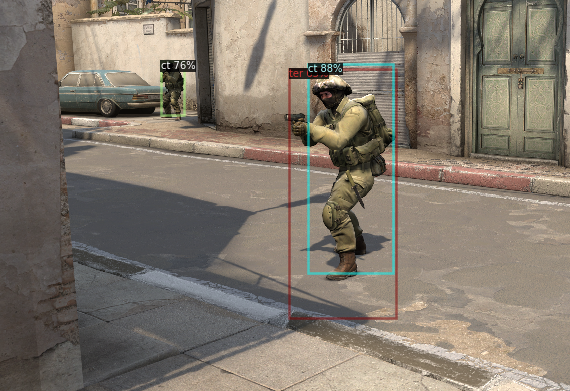

/content/csgodataset/215.png


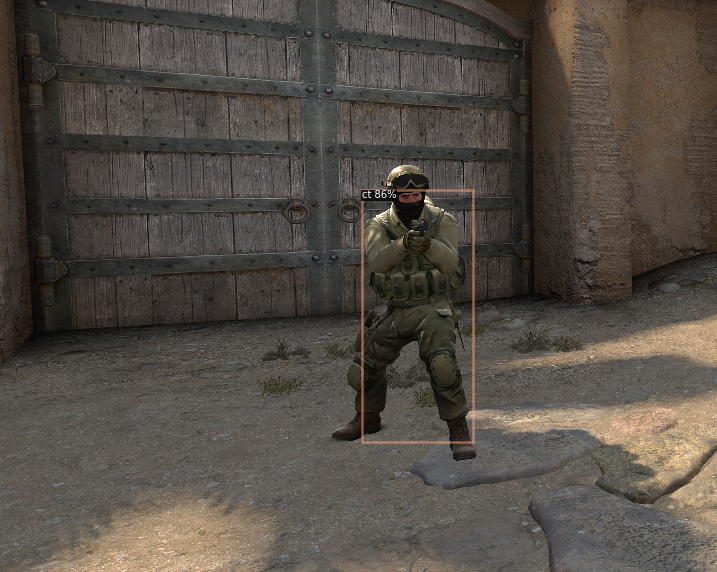

/content/csgodataset/149.png


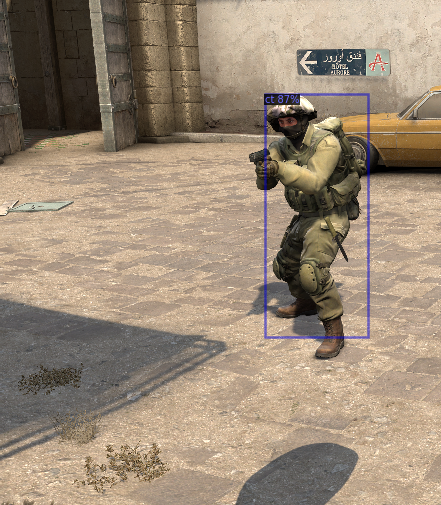

/content/csgodataset/182.png


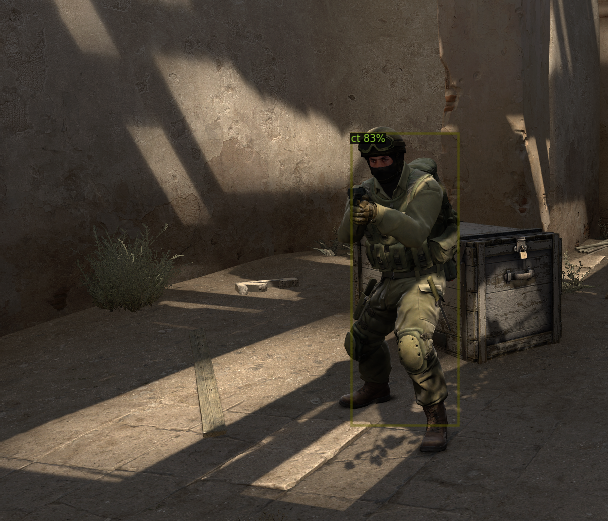

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 4): 
    im = cv2.imread(d["file_name"])
    print(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=sample_metadata, 
                   scale=0.5 
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

After Human Evaluation, it looks dataset is balanced and predicts the right categories in most  image instaces. CT have 111  image instances and     ter catgory have 102 image instances.

In [ ]:
f= open("config.yaml","w") # Download Config File
f.write(cfg.dump())
f.close()

### Automated Evaluation

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("experiment", output_dir="/content/output")
val_loader = build_detection_test_loader(cfg, "experiment")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [10/26 14:04:02 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/26 14:04:02 d2.data.datasets.coco]: Loaded 196 images in COCO format from /content/output.json
[10/26 14:04:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/26 14:04:02 d2.data.common]: Serializing 196 elements to byte tensors and concatenating them all ...
[10/26 14:04:02 d2.data.common]: Serialized dataset takes 0.04 MiB
[10/26 14:04:02 d2.evaluation.evaluator]: Start inference on 196 batches
[10/26 14:04:05 d2.evaluation.evaluator]: Inference done 11/196. Dataloading: 0.0858 s/iter. Inference: 0.1159 s/iter. Eval: 0.0003 s/iter. Total: 0.2020 s/iter. ETA=0:00:37
[10/26 14:04:10 d2.evaluation.evaluator]: Inference done 51/196. Dataloading: 0.0174 s/iter. Inference: 0.1174 s/iter. Eval: 0.0003 s/iter. Total: 0.1352 s/iter. ETA

> It's similar to human evaluation visible results and models performs average. Model got average AP of 50. As per categories model can got average precision of 54 for "CT" category and average precision of 47 for "TER" Category

## Add Public Dataset to same model

## Register the COCO format dataset in a experiment

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("experiment1", {}, "/content/csgodataset/CSGO.v3-v2-640.coco/train/_annotations.coco.json", "/content/csgodataset/CSGO.v3-v2-640.coco/train")

In [ ]:
sample_metadata = MetadataCatalog.get("experiment1")
dataset_dicts = DatasetCatalog.get("experiment1")

WARNING [10/26 14:07:30 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/26 14:07:30 d2.data.datasets.coco]: Loaded 969 images in COCO format from /content/csgodataset/CSGO.v3-v2-640.coco/train/_annotations.coco.json


To verify the dataset is in correct format, let's visualize the annotations of randomly selected samples in the training set:



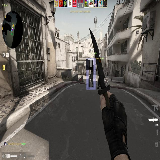

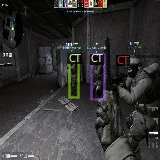

In [ ]:
import random

for d in random.sample(dataset_dicts, 2):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=sample_metadata, scale=0.25)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## Re-Training

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("experiment1",)
cfg.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")# initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2 # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.02 # Best tested LR
cfg.SOLVER.MAX_ITER = 500   # + 200 iterations on the base model
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128  
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 # Contain two classes, ter and ct

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[10/26 14:07:38 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 513), started 0:05:40 ago. (Use '!kill 513' to kill it.)

<IPython.core.display.Javascript object>

## Evaluation of Re-Trained Model

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6   # set the testing threshold for this model
cfg.DATASETS.TEST = ("experiment1",)
predictor = DefaultPredictor(cfg)

[10/26 14:08:46 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

### Human Evaluation

/content/csgodataset/CSGO.v3-v2-640.coco/train/73_png.rf.ea3b877818d122efed792f52096f5384.jpg


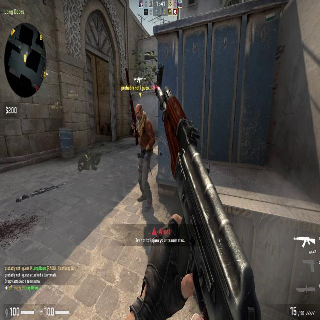

/content/csgodataset/CSGO.v3-v2-640.coco/train/8_png.rf.f121baf110ae2d2106b5bc1ee6fa011e.jpg


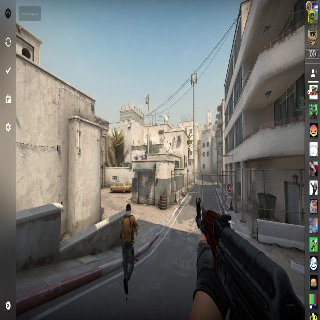

/content/csgodataset/CSGO.v3-v2-640.coco/train/952_png.rf.7f1b13fde81bf392b9865d09fdd56f3a.jpg


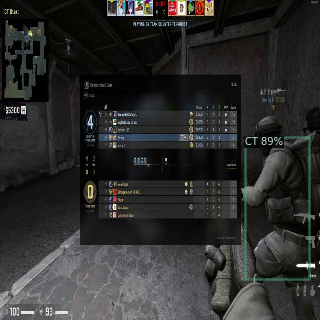

/content/csgodataset/CSGO.v3-v2-640.coco/train/654_png.rf.b2372ea2458ce4a7660ebc985f3a9b7d.jpg


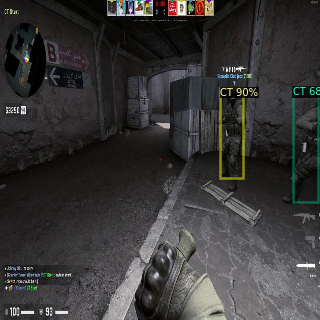

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 4): 
    im = cv2.imread(d["file_name"])
    print(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=sample_metadata,  
                   scale=0.5 
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

### Automated Evaluation

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("experiment1", output_dir="/content/output")
val_loader = build_detection_test_loader(cfg, "experiment1")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [10/26 14:10:17 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/26 14:10:17 d2.data.datasets.coco]: Loaded 969 images in COCO format from /content/csgodataset/CSGO.v3-v2-640.coco/train/_annotations.coco.json
[10/26 14:10:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/26 14:10:17 d2.data.common]: Serializing 969 elements to byte tensors and concatenating them all ...
[10/26 14:10:18 d2.data.common]: Serialized dataset takes 0.29 MiB
[10/26 14:10:18 d2.evaluation.evaluator]: Start inference on 969 batches
[10/26 14:10:19 d2.evaluation.evaluator]: Inference done 11/969. Dataloading: 0.0018 s/iter. Inference: 0.0821 s/iter. Eval: 0.0001 s/iter. Total: 0.0840 s/iter. ETA=0:01:20
[10/26 14:10:24 d2.evaluation.evaluator]: Inference done 70/969. Dataloading: 0.0019 s/iter. Inference: 0.0827 s/ite

It's similar to human evaluation but performing worst with publically available dataset. This dataset is highly biased toward "CT" category and can not detect the "T" category. AP for "CT" dropped by 30 AP and "T" category is performing worst.

## Save the Model

In [ ]:
# Download Config File
f= open("publicconfig.yaml","w")
f.write(cfg.dump())
f.close()

# Fresh Training on Public Dataset

## Training From Scratch on public data model rather than retraining on custom data model.

After looking at the influcence on accuracy by public dataset. I wanted to test a new model specifically trained on large public dataset and check the accuracy again. This test is only performed to see the effects of large dataset in training.

##Important Information

>Note >>  Delete the runtime and restart again to replicate the results. Run below cells once runtime is terminated.

## Required Library Installation and Detectron Setup

In [ ]:
!python -m pip install pyyaml==5.1
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 5.0 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=da40161547a2dbccec8e76612e62b1edb66c7178965abd5047f958abe7b24b62
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.0 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/d

## Dataset Cloning from Github

In [ ]:
!git clone https://github.com/rootsid/csgodataset.git

Cloning into 'csgodataset'...
remote: Enumerating objects: 1631, done.
remote: Counting objects: 100% (241/241), done.
remote: Compressing objects: 100% (236/236), done.
remote: Total 1631 (delta 5), reused 241 (delta 5), pack-reused 1390
Receiving objects: 100% (1631/1631), 426.45 MiB | 34.69 MiB/s, done.
Resolving deltas: 100% (7/7), done.
Checking out files: 100% (1581/1581), done.


Verify the version of torch and detectron2 installation

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
torch:  1.12 ; cuda:  cu113
detectron2: 0.6


## Import Required Libraries

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

## Register the COCO format dataset in a experiment

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("experiment1", {}, "/content/csgodataset/CSGO.v3-v2-640.coco/train/_annotations.coco.json", "/content/csgodataset/CSGO.v3-v2-640.coco/train")

In [ ]:
sample_metadata = MetadataCatalog.get("experiment1")
dataset_dicts = DatasetCatalog.get("experiment1")

WARNING [10/26 13:13:58 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/26 13:13:58 d2.data.datasets.coco]: Loaded 969 images in COCO format from /content/csgodataset/CSGO.v3-v2-640.coco/train/_annotations.coco.json


To verify the dataset is in correct format, let's visualize the annotations of randomly selected samples in the training set:



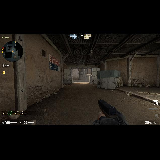

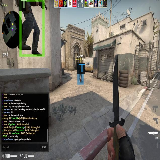

In [ ]:
import random

for d in random.sample(dataset_dicts, 2):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=sample_metadata, scale=0.25)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## Training

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("experiment1",)
cfg.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")# initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2 # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.02 # Best tested LR
cfg.SOLVER.MAX_ITER = 300
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128  # The "RoIHead batch size". 128 is faster.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 # Contain two classes, ter and ct

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[10/26 13:16:26 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:03, 48.8MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[10/26 13:16:35 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2894.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[10/26 13:16:50 d2.utils.events]:  eta: 0:01:23  iter: 19  total_loss: 0.8978  loss_cls: 0.497  loss_box_reg: 0.1543  loss_rpn_cls: 0.01986  loss_rpn_loc: 0.01335  time: 0.2984  data_time: 0.0215  lr: 0.0012854  max_mem: 1824M
[10/26 13:16:56 d2.utils.events]:  eta: 0:01:17  iter: 39  total_loss: 0.5608  loss_cls: 0.1594  loss_box_reg: 0.3681  loss_rpn_cls: 0.01436  loss_rpn_loc: 0.008981  time: 0.2966  data_time: 0.0110  lr: 0.0026174  max_mem: 1824M
[10/26 13:17:02 d2.utils.events]:  eta: 0:01:10  iter: 59  total_loss: 0.2829  loss_cls: 0.06447  loss_box_reg: 0.154  loss_rpn_cls: 0.01553  loss_rpn_loc: 0.01165  time: 0.2962  data_time: 0.0101  lr: 0.0039494  max_mem: 1824M
[10/26 13:17:07 d2.utils.events]:  eta: 0:01:04  iter: 79  total_loss: 0.2783  loss_cls: 0.06733  loss_box_reg: 0.1398  loss_rpn_cls: 0.01289  loss_rpn_loc: 0.01498  time: 0.2924  data_time: 0.0107  lr: 0.0052814  max_mem: 1824M
[10/26 13:17:14 d2.utils.events]:  eta: 0:00:58  iter: 99  total_loss: 0.193  loss_cls:

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Evaluation of Trained Public Model

### Human Evaluation

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth") # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6   # set the testing threshold for this model
cfg.DATASETS.TEST = ("experiment1",)
predictor = DefaultPredictor(cfg)

[10/26 13:18:24 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

Then, we randomly select several samples to visualize the prediction results.

/content/csgodataset/CSGO.v3-v2-640.coco/train/2719_png.rf.08c3a4b97dc72d9b97a9ac7e338037d8.jpg


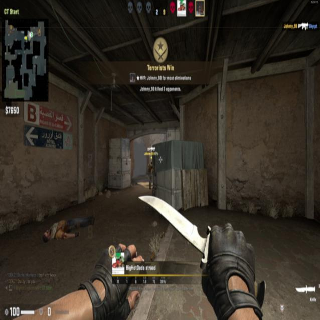

/content/csgodataset/CSGO.v3-v2-640.coco/train/2267_png.rf.283cc3d1afcee225c1130a53a228bb0e.jpg


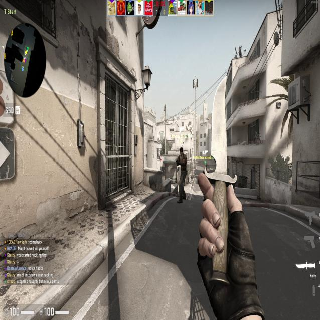

/content/csgodataset/CSGO.v3-v2-640.coco/train/1_png.rf.85917bf9ff7da0f561913e9e166f14b7.jpg


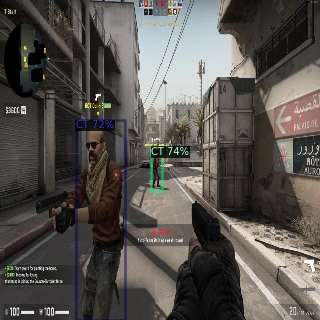

/content/csgodataset/CSGO.v3-v2-640.coco/train/2470_png.rf.ef71a152875dd4457ad0d96eca28732f.jpg


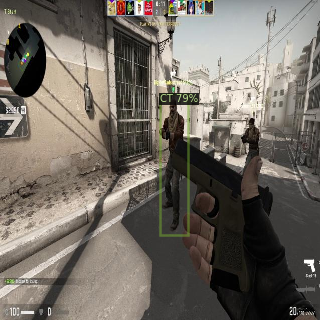

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 4): 
    im = cv2.imread(d["file_name"])
    print(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=sample_metadata,  
                   scale=0.5 
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

After Human Evaluation, it looks dataset is still more biased towards the "CT" category side rather than "T" side. As there are more images of CT have  799 instances and T side have 619 image instances.

### Automated Evaluation

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("experiment1", output_dir="/content/output")
val_loader = build_detection_test_loader(cfg, "experiment1")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [10/26 13:18:49 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/26 13:18:49 d2.data.datasets.coco]: Loaded 969 images in COCO format from /content/csgodataset/CSGO.v3-v2-640.coco/train/_annotations.coco.json
[10/26 13:18:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/26 13:18:49 d2.data.common]: Serializing 969 elements to byte tensors and concatenating them all ...
[10/26 13:18:49 d2.data.common]: Serialized dataset takes 0.29 MiB
[10/26 13:18:49 d2.evaluation.evaluator]: Start inference on 969 batches
[10/26 13:18:51 d2.evaluation.evaluator]: Inference done 11/969. Dataloading: 0.0032 s/iter. Inference: 0.0839 s/iter. Eval: 0.0001 s/iter. Total: 0.0872 s/iter. ETA=0:01:23
[10/26 13:18:56 d2.evaluation.evaluator]: Inference done 72/969. Dataloading: 0.0024 s/iter. Inference: 0.0801 s/ite

It's similar to human evaluation but performing worst with publically available dataset. This dataset is highly biased toward "CT" category and can not detect the "T" category.

# Discussion

Training again on custom private dataset with public dataset, still improved the accuracy a bit more on public dataset, however behaves similar on custom dataset.
Previously with retraining on custom dataset, it could detect the CT category more by 30 AP and accuracy dropped on public dataset model. Possible reason for accuracy drop can be seen in image instance quality. All image instances available in public dataset are low quality or stretched which leads to distrotion and model can not perform well. Custom Designed which contains 4K image instances perform extremely better in this case.